In [ ]:
!wget http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/facades.tar.gz
# !mkdir /content/facades/
!tar xvzf facades.tar.gz -C '/content/'

### Start

In [1]:
# from google.colab import drive
# drive.mount('/content/gdrive/')
# path_to_files = '/content/gdrive/My Drive/_made/advancedml/'
import os
from pathlib import Path
from collections import Counter, defaultdict
import numpy as np

from tqdm.notebook import tqdm
from IPython.display import clear_output
import time

import matplotlib.pyplot as plt
import seaborn as sns
import json
import math
import random
import numpy as np
import scipy as sp
import scipy.stats
import pickle

# sns.set_style("whitegrid")
# sns.set_palette("colorblind")
palette = sns.color_palette()
# legend_fontsize = 16

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.transforms as transforms

from torch.utils.data import Dataset, DataLoader

In [ ]:
base_path = Path('/content/facades/')

paths = defaultdict(list)
shapes = set([])
for d in ['train', 'test', 'val']:
    paths[d] = sorted([os.path.abspath(base_path / d / f) for f in os.listdir(base_path / d)])
    print(len(paths[d]))
    for p in paths[d]:
        img = plt.imread(p)
        shapes.add(img.shape)

shapes

400
106
100


{(256, 512, 3)}

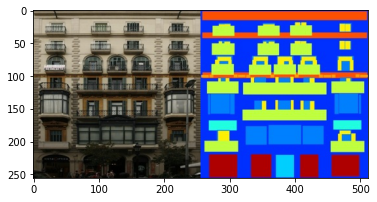

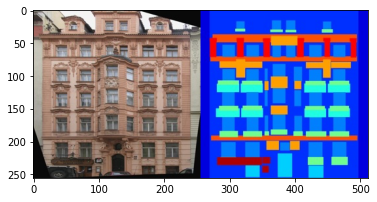

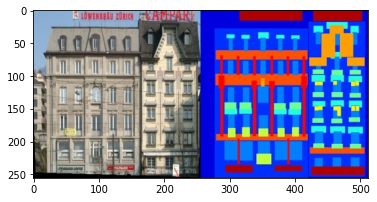

In [ ]:
figsize = (6,4)
for d in paths:
    fig, ax = plt.subplots(1,1,figsize = figsize)
    img = plt.imread(np.random.choice(paths[d]))
    ax.imshow(img);

### Dataset, splitting paired image into 'condition' and 'ground truth' parts

In [ ]:
class Pix2PixDataset(torch.utils.data.Dataset):
    
    def __init__(self, base_path, halfwidth = 256):
        self.base_path = Path(base_path)
        self.img_paths = sorted([base_path / f for f in os.listdir(base_path) if f.endswith('.jpg')])
        self.transforms = transforms.Compose(
            [
                transforms.ToTensor(),
            ]
        )
        self.halfwidth = halfwidth
        
    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        p = self.img_paths[idx]
        img = plt.imread(p) ### h x w x c
        style, condition = img[:, :self.halfwidth, :], img[:, self.halfwidth:, :] 
        return self.transforms(style), self.transforms(condition)   
        

batch_size = 32

train_dataset = Pix2PixDataset(base_path = base_path / 'train')
train_dataloader = DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True
)

test_dataset = Pix2PixDataset(base_path = base_path / 'test')
test_dataloader = DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=False,
)

val_dataset = Pix2PixDataset(base_path = base_path / 'val')
val_dataloader = DataLoader(
    val_dataset,
    batch_size=batch_size,
    shuffle=False,
)

### Visualiser

In [ ]:
from matplotlib import gridspec

def visualize(condition_batch, style_batch, generated_batch, figsize=(8, 8)):
    n = len(condition_batch)
    # fig, ax = plt.subplots(n, 3, gridspec_kw = {'hspace':0}, figsize=figsize, constrained_layout=False)
    # fig.tight_layout();
    fig = plt.figure(figsize=figsize,)
    nrow, ncol = n, 3
    gs = gridspec.GridSpec(
        nrow, ncol, wspace=0.0, hspace=0.0,
        #  width_ratios=[1, 1, 1],
        # top=1.-0.5/(nrow+1), bottom=0.5/(nrow+1), 
        # left=0.5/(ncol+1), right=1-0.5/(ncol+1)
    )

    for i in range(nrow):
        condition, style, generated = condition_batch[i], style_batch[i], generated_batch[i]
        # back to h x w x c
        style, condition, generated = (
            style.detach().cpu().permute(1, 2, 0).numpy(),
            condition.detach().cpu().permute(1, 2, 0).numpy(),
            generated.detach().cpu().permute(1, 2, 0).numpy(),
        )        
        for j, element in zip(range(ncol), (condition, style, generated)):
            ax = plt.subplot(gs[i, j])
            ax.imshow(element)
            ax.set_xticklabels([])
            ax.set_yticklabels([])
            ax.set_xticks([])
            ax.set_yticks([])
    # fig.subplots_adjust(wspace=None, hspace=None)        
    plt.show();

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:126: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ../torch/csrc/utils/tensor_numpy.cpp:189.)
  img = torch.from_numpy(pic.transpose((2, 0, 1))).contiguous()


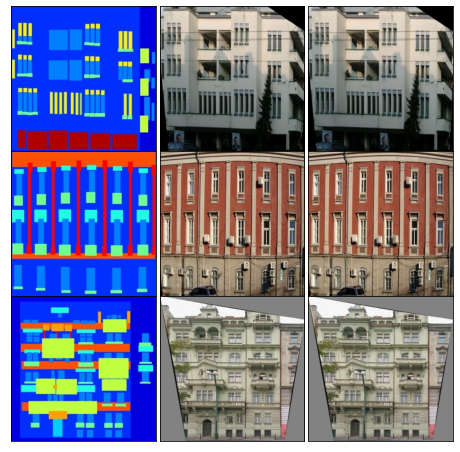

In [ ]:
style_batch, condition_batch = next(iter(DataLoader(
    train_dataset,
    batch_size=3,
    shuffle=False,
)))
visualize(condition_batch, style_batch, style_batch)

In [ ]:
style = style_batch[0]
print(style.min(), style.max()) ### already normalized
print(style.shape)

tensor(0.) tensor(0.9686)
torch.Size([3, 256, 256])


## Часть первая: перенос стиля при помощи pix2pix

В этом задании мы будем реализовывать перенос стиля на спаренных данных (paired
data). Из стандартных датасетов я выбрал самый маленький -- давайте реализуем перенос
стиля из масок сегментации в “настоящие фотографии” для конкретного случая фасадов
домов

### Pix2Pix GAN

U-net implementation based on https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix/

but instead of transposed convolutions using upsample + conv2d based on advice from https://distill.pub/2016/deconv-checkerboard/

In [ ]:
# t = torch.ones((1, 4, 3, 3))
# Ul = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
# print(Ul(t).shape)
# Cl = nn.Conv2d(4, 4, kernel_size=3, stride=1, padding=1, dilation=1, bias=True)
# Cl(Ul(t)).shape

#### U-Net

In [2]:
import functools

class Identity(nn.Module):
    def forward(self, x):
        return x

def get_norm_layer(norm_type='instance'):
    """Return a normalization layer
    Parameters:
        norm_type (str) -- the name of the normalization layer: batch | instance | none
    For BatchNorm, we use learnable affine parameters and track running statistics (mean/stddev).
    For InstanceNorm, we do not use learnable affine parameters. We do not track running statistics.
    """
    if norm_type == 'batch':
        norm_layer = functools.partial(nn.BatchNorm2d, affine=True, track_running_stats=True)
    elif norm_type == 'instance':
        norm_layer = functools.partial(nn.InstanceNorm2d, affine=False, track_running_stats=False)
    elif norm_type == 'none':
        def norm_layer(x): 
            return Identity()
    else:
        raise NotImplementedError('normalization layer [%s] is not found' % norm_type)
    return norm_layer

class UNetSkipConnectionBlock(nn.Module):
    """Defines the Unet submodule with skip connection.
        X -------------------identity----------------------
        |-- downsampling -- |submodule| -- upsampling --|
    """

    def __init__(
        self,
        outer_nc,
        inner_nc,
        input_nc=None,
        submodule=None,
        # outermost=False, innermost=False,
        block_position = 'middle',
        norm_layer=nn.BatchNorm2d,
        use_dropout=False,
    ):
        """Construct a Unet submodule with skip connections.
        Parameters:
            outer_nc (int) -- the number of filters in the outer conv layer
            inner_nc (int) -- the number of filters in the inner conv layer
            input_nc (int) -- the number of channels in input images/features
            submodule (UNetSkipConnectionBlock) -- previously defined submodules
            norm_layer          -- normalization layer
            use_dropout (bool)  -- if use dropout layers.
        """
        super(UNetSkipConnectionBlock, self).__init__()
        assert block_position in ('innermost', 'outermost', 'middle')
        self.block_position = block_position

        if type(norm_layer) == functools.partial:
            use_bias = (norm_layer.func == nn.InstanceNorm2d)
        else:
            use_bias = (norm_layer == nn.InstanceNorm2d)

        if input_nc is None:
            input_nc = outer_nc

        downconv = nn.Conv2d(input_nc, inner_nc, kernel_size=4, stride=2, padding=1, bias=use_bias)
        downrelu = nn.LeakyReLU(0.2, inplace = True)
        downnorm = norm_layer(inner_nc)

        def make_upconv(input_nc):
            upconv = nn.Sequential(*[
                nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True),
                nn.Conv2d(input_nc, outer_nc, kernel_size=3, stride=1, padding=1, dilation=1, bias=True),
            ])
            # H_out = (H_in + 2 × padding − dilation × (kernel_size−1) − 1) / stride  + 1
            # dilation == padding == stride == 1
            # H_out == H_in == H => (H - 1) * 1 = H + 2 * 1 - 1 * (k - 1) - 1
            # 2 - (k - 1) = 0 => k = 3
            return upconv
        uprelu = nn.ReLU(inplace = False)
        upnorm = norm_layer(outer_nc)

        if block_position == 'outermost':
            # upconv = nn.ConvTranspose2d(
            #     inner_nc * 2, outer_nc,
            #     kernel_size=4, stride=2,
            #     padding=1
            # )
            upconv = make_upconv(inner_nc * 2)
            down = [downconv]
            # up = [uprelu, upconv, nn.Tanh()]
            up = [uprelu, upconv, nn.Sigmoid()]
            model = down + [submodule] + up
        elif block_position == 'innermost':
            # upconv = nn.ConvTranspose2d(
            #     inner_nc, outer_nc,
            #     kernel_size=4, stride=2,
            #     padding=1, bias=use_bias
            # )
            upconv = make_upconv(inner_nc)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            # upconv = nn.ConvTranspose2d(
            #     inner_nc * 2, outer_nc,
            #     kernel_size=4, stride=2,
            #     padding=1, bias=use_bias
            # )
            upconv = make_upconv(inner_nc * 2) 
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]

            if use_dropout:
                model = down + [submodule] + up + [nn.Dropout(0.5)]
            else:
                model = down + [submodule] + up

        self.model = nn.Sequential(*model)

    def forward(self, x):
        if self.block_position == 'outermost':
            return self.model(x)
        else:
            # add skip connections
            return torch.cat([x, self.model(x)], dim = 1) ### concatenating on channels


class UNet(nn.Module):
    def __init__(self, input_nc, output_nc, num_downs, ngf=64, norm_layer=nn.BatchNorm2d, use_dropout=False):
        """Construct a Unet generator
        Parameters:
            input_nc (int)  -- the number of channels in input images
            output_nc (int) -- the number of channels in output images
            num_downs (int) -- the number of downsamplings in UNet. For example, # if |num_downs| == 7,
                                image of size 128x128 will become of size 1x1 # at the bottleneck
            ngf (int)       -- the number of filters in the last conv layer
            norm_layer      -- normalization layer
        We construct the U-Net from the innermost layer to the outermost layer.
        It is a recursive process.
        """
        super(UNet, self).__init__()
        # construct unet structure
        unet_block = UNetSkipConnectionBlock(ngf * 8, ngf * 8, input_nc=None, submodule=None, block_position = 'innermost', norm_layer=norm_layer,)  # the innermost layer
        for i in range(num_downs - 5):          # add intermediate layers with ngf * 8 filters
            unet_block = UNetSkipConnectionBlock(ngf * 8, ngf * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer, use_dropout=use_dropout)
        # gradually reduce the number of filters from ngf * 8 to ngf
        unet_block = UNetSkipConnectionBlock(ngf * 4, ngf * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
        unet_block = UNetSkipConnectionBlock(ngf * 2, ngf * 4, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
        unet_block = UNetSkipConnectionBlock(ngf, ngf * 2, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
        self.model = UNetSkipConnectionBlock(output_nc, ngf, input_nc=input_nc, submodule=unet_block, block_position = 'outermost', norm_layer=norm_layer)  # add the outermost layer

    def forward(self, input):
        """Standard forward"""
        return self.model(input)

#### PatchGAN

In [3]:
class PatchGAN(nn.Module):
    """
    Defines a PatchGAN discriminator
    with n_layers == 3
    on input [batch_size, 1, 256, 256] returns [batch_size, 1, 30, 30] tensor - logits of each 70x70 patch being real and not generated
    """

    def __init__(self, input_nc, ndf=64, n_layers = 3, norm_layer=nn.BatchNorm2d):
        """Construct a PatchGAN discriminator
        Parameters:
            input_nc (int)  -- the number of channels in input images
            ndf (int)       -- the number of filters in the last conv layer
            n_layers (int)  -- the number of conv layers in the discriminator
            norm_layer      -- normalization layer
        """
        super(PatchGAN, self).__init__()
        if type(norm_layer) == functools.partial:  # no need to use bias as BatchNorm2d has affine parameters
            use_bias = norm_layer.func == nn.InstanceNorm2d
        else:
            use_bias = norm_layer == nn.InstanceNorm2d

        # n_layers = 3 ### hardcoded to match the paper
        kw = 4
        padw = 1
        sequence = [nn.Conv2d(input_nc, ndf, kernel_size=kw, stride=2, padding=padw), nn.LeakyReLU(0.2, inplace = False)]
        nf_mult = 1
        nf_mult_prev = 1
        for n in range(1, n_layers):  # gradually increase the number of filters
            nf_mult_prev = nf_mult
            nf_mult = min(2 ** n, 8)
            sequence += [
                nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=kw, stride=2, padding=padw, bias=use_bias),
                norm_layer(ndf * nf_mult),
                nn.LeakyReLU(0.2, inplace = False)
            ]

        nf_mult_prev = nf_mult
        nf_mult = min(2 ** n_layers, 8)
        sequence += [
            nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=kw, stride=1, padding=padw, bias=use_bias),
            norm_layer(ndf * nf_mult),
            nn.LeakyReLU(0.2, inplace = False)
        ]

        sequence += [nn.Conv2d(ndf * nf_mult, 1, kernel_size=kw, stride=1, padding=padw)]  # output 1 channel prediction map
        self.model = nn.Sequential(*sequence)

    def forward(self, input):
        return self.model(input)

#### ConvNet Simple

In [4]:
def make_conv_block(in_challels, out_channels):
    return nn.Sequential(
        nn.Conv2d(in_challels, out_channels, kernel_size=3, padding=1),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.LeakyReLU(0.2, inplace=False),
        nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.LeakyReLU(0.2, inplace=False),
    )

class ConvNetSimple(nn.Module):
    def __init__(self, in_channels = 6, start_channels = 32, n_blocks = 4):
        super().__init__()
    
        self.conv_layers = [make_conv_block(in_channels, start_channels)]    
        for i in range(n_blocks):
            self.conv_layers.append(make_conv_block(int(start_channels * 2 ** i), int(start_channels * 2 ** (i + 1))))
            self.conv_layers.append(nn.MaxPool2d(kernel_size=2))
            self.conv_layers.append(nn.Dropout())
        
        self.conv_layers = nn.Sequential(*self.conv_layers)
        self.fc = nn.Linear(int(start_channels * 2 ** (i + 1)), 1)
        # self.activation_out = nn.Sigmoid()
        # self.local_pool = nn.MaxPool2d(kernel_size=2)
        self.global_pool = nn.AdaptiveAvgPool2d((1, 1))

    # def to(self, device):
    #     super(ConvNetSimple, self).to(device)
    #     for l in self.conv_layers:
    #         l.to(device)

    def forward(self, x):
        x = self.conv_layers(x)
        x = self.global_pool(x)
        x = x.squeeze(-1).squeeze(-1) 
        x = self.fc(x)

        return x

In [ ]:
# generator = UNet(input_nc = 3, output_nc = 3, num_downs = 6, ngf=64, norm_layer=nn.BatchNorm2d, use_dropout=True) ### dropout == True on forward implicitly adds noise to generation
# style, condition = train_dataset[0]
# style.shape, generator(style.unsqueeze(0)).shape

(torch.Size([3, 256, 256]), torch.Size([1, 3, 256, 256]))

In [ ]:
# pgan = PatchGAN(6, 64, 3).eval()
# pgan_out = pgan(torch.cat([style, condition], dim = 0).unsqueeze(0))

# logits = pgan_out
# labels = torch.tensor(1.0).expand_as(logits)
# # ce_loss = nn.CrossEntropyLoss()
# ce_loss = nn.BCEWithLogitsLoss(reduction = 'none')
# ce_loss(logits, labels, ).shape

torch.Size([1, 1, 30, 30])

#### Pix2Pix

In [ ]:
class Pix2Pix:
    def __init__(
        self,
        generator,
        discriminator,
        discriminator_loss_fn = nn.BCEWithLogitsLoss(reduction = 'mean'),#nn.CrossEntropyLoss(),
        restoration_loss_fn = torch.nn.SmoothL1Loss(),
        generator_d_loss_weight = 1e1,
        generator_r_loss_weight = 1e3,
        device = 'cpu',
        # noise_shape = None,
    ):

        self.device = device

        self.generator = generator.to(self.device)
        self.discriminator = discriminator.to(self.device)
        self.discriminator_loss_fn = discriminator_loss_fn
        self.restoration_loss_fn = restoration_loss_fn

        self.generator_d_loss_weight = generator_d_loss_weight
        self.generator_r_loss_weight = generator_r_loss_weight

        self.g_optimizer = torch.optim.Adam(self.generator.parameters(), lr=0.0002, )
        self.d_optimizer = torch.optim.Adam(self.discriminator.parameters(), lr=0.0002, )

    def add_noise(self, condition):
        condition = condition.to(self.device)
        shape = list(condition.size())
        noise_shape = tuple([shape[0], 1] + shape[2:])
        noise_generator = torch.distributions.Normal(torch.zeros(noise_shape), torch.ones(noise_shape) * 0.8) ### maybe explore scale parameter
        noise = noise_generator.sample().to(self.device)
        condition = torch.cat([condition, noise], dim = 1) ### adding noise as another channel - but that should be accounted in generator input conv layer
        return condition

    def make_train_step(self, batch, add_noise = False):
        style, condition = batch
        style = style.to(self.device) ### true images, close to which we want to generate
        condition = condition.to(self.device)
        
        if add_noise:
            condition = self.add_noise(condition)

        self.generator.train()
        self.discriminator.train()

        generated = self.generator(condition)

        discriminator_input_generated = torch.cat([generated, condition], dim = 1)
        logits_generated = self.discriminator(discriminator_input_generated)
        ### here we want discriminator to fail to identify correctly, but we minimizing loss so it's either "-" or providing wrong labels == 1
        # ones = torch.ones(logits_generated.size(0), dtype = torch.long, requires_grad=False).to(self.device)
        ones = torch.tensor(1.0).expand_as(logits_generated).to(self.device)
        loss_discrimination = self.discriminator_loss_fn(logits_generated, ones) 

        loss_restoration = self.restoration_loss_fn(generated, style)

        loss_g = self.generator_d_loss_weight * loss_discrimination + self.generator_r_loss_weight * loss_restoration
        self.g_optimizer.zero_grad()
        loss_g.backward()
        self.g_optimizer.step()

        ### do we need to forward generator second time??
        ### or discriminator??
        ### maybe not, but detaching instead
        # generated = self.generator(condition)
        discriminator_input_generated = torch.cat([generated.detach(), condition], dim = 1)
        logits_generated = self.discriminator(discriminator_input_generated)
        discriminator_input_true = torch.cat([style, condition], dim = 1)
        logits_true = self.discriminator(discriminator_input_true)
        
        zeros = torch.tensor(0.0).expand_as(logits_generated).to(self.device)
        ones = torch.tensor(1.0).expand_as(logits_true).to(self.device)
        # zeros = torch.zeros(logits_generated.size(0), dtype = torch.long, requires_grad=False).to(self.device)
        # ones = torch.ones(logits_true.size(0), dtype = torch.long, requires_grad=False).to(self.device)

        loss_generated = self.discriminator_loss_fn(logits_generated, zeros)
        loss_true = self.discriminator_loss_fn(logits_true, ones)
        loss_d = (loss_true + loss_generated) / 2
        self.d_optimizer.zero_grad()
        loss_d.backward()
        self.d_optimizer.step()

        return loss_g.item(), loss_d.item()

    def generate(self, condition, add_noise = False):
        self.generator.eval()
        with torch.no_grad():
            if add_noise:
                condition = self.add_noise(condition)
            generated = self.generator(condition.to(self.device))
        return generated

#### Train Loop

In [ ]:
batch_size = 16

train_dataset = Pix2PixDataset(base_path = base_path / 'train')
train_dataloader = DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True
)

test_dataset = Pix2PixDataset(base_path = base_path / 'test')
test_dataloader = DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=False,
)

val_dataset = Pix2PixDataset(base_path = base_path / 'val')
val_dataloader = DataLoader(
    val_dataset,
    batch_size=4,
    shuffle=False,
)

In [ ]:
GEN_N_INPUT_CHANNELS = 3
DISC_N_INPUT_CHANNELS = GEN_N_INPUT_CHANNELS * 2
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

pix2pix = Pix2Pix(
    generator = UNet(GEN_N_INPUT_CHANNELS, GEN_N_INPUT_CHANNELS, num_downs = 7, use_dropout=False),
    discriminator = PatchGAN(DISC_N_INPUT_CHANNELS, ndf = 128, norm_layer = nn.InstanceNorm2d),
    generator_d_loss_weight = 1e1,
    generator_r_loss_weight = 1e3,
    device = device,    
)

cuda


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

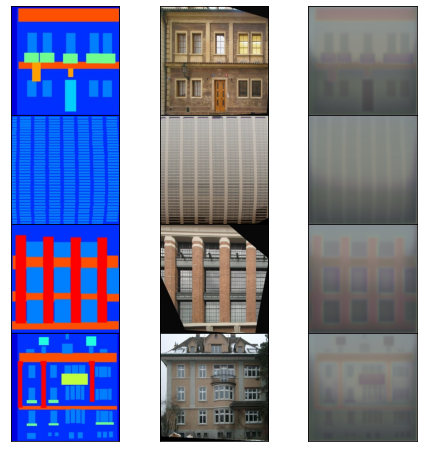

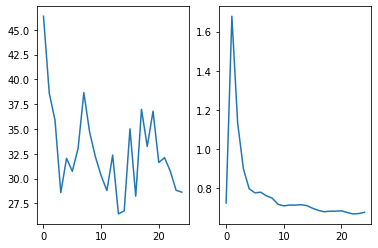

  0%|          | 0/25 [00:00<?, ?it/s]

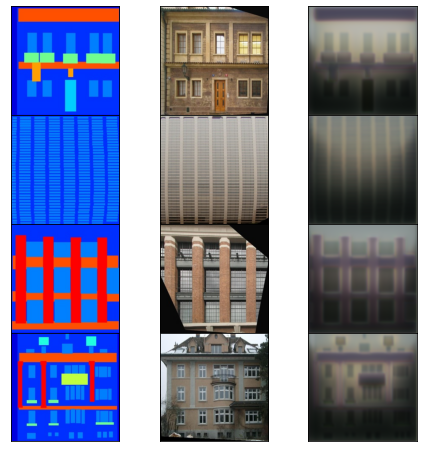

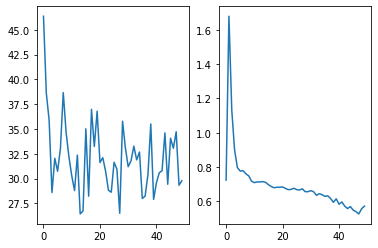

  0%|          | 0/25 [00:00<?, ?it/s]

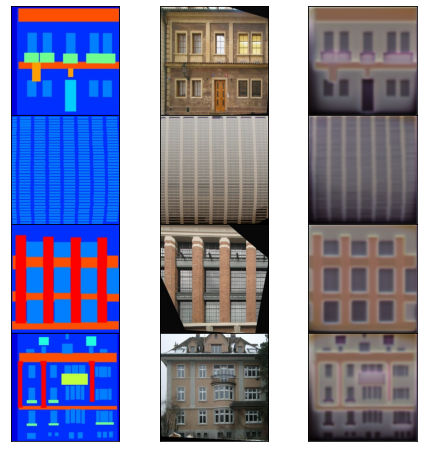

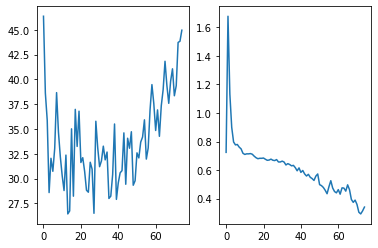

  0%|          | 0/25 [00:00<?, ?it/s]

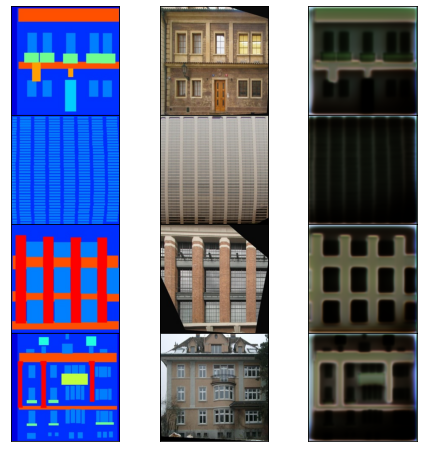

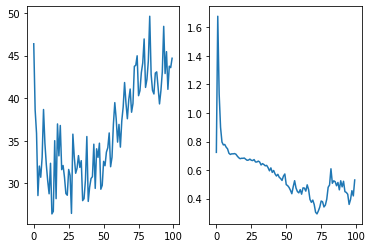

  0%|          | 0/25 [00:00<?, ?it/s]

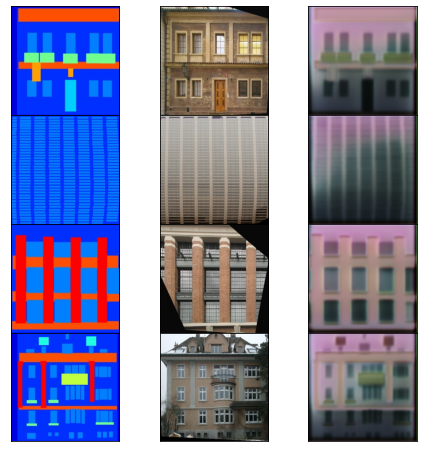

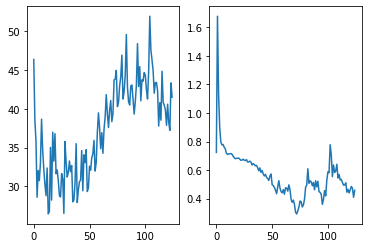

  0%|          | 0/25 [00:00<?, ?it/s]

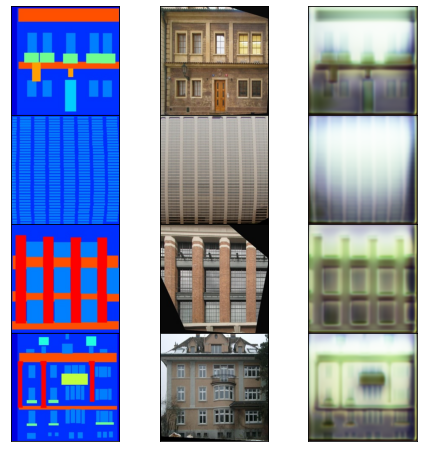

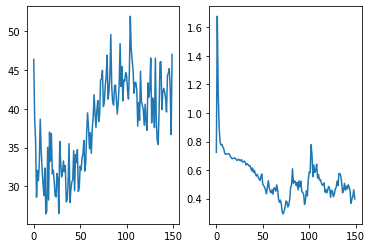

  0%|          | 0/25 [00:00<?, ?it/s]

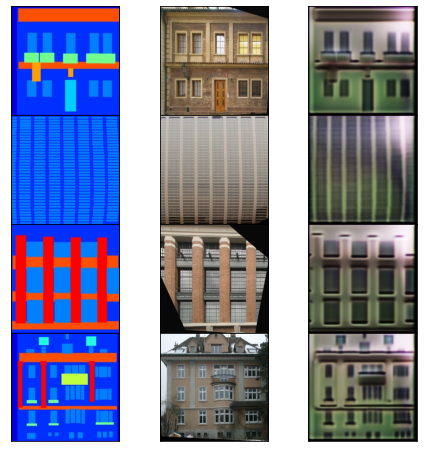

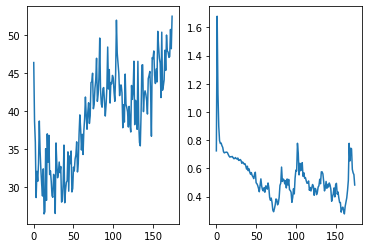

  0%|          | 0/25 [00:00<?, ?it/s]

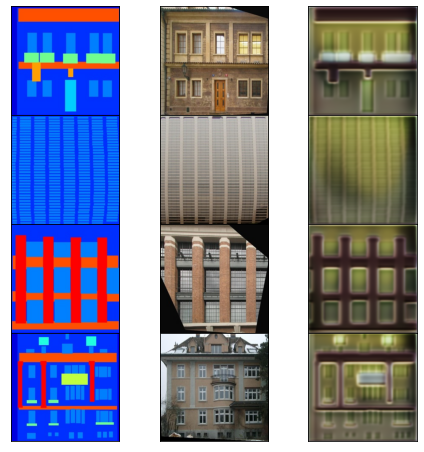

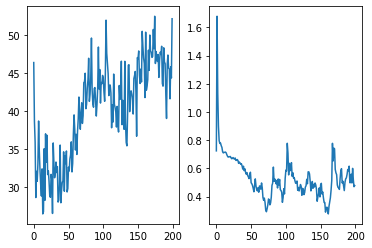

  0%|          | 0/25 [00:00<?, ?it/s]

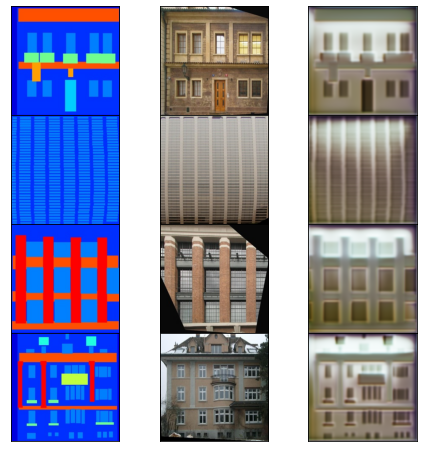

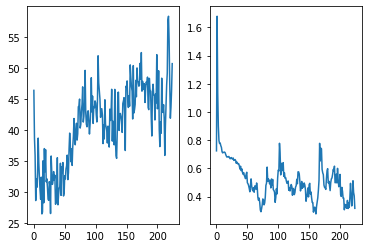

  0%|          | 0/25 [00:00<?, ?it/s]

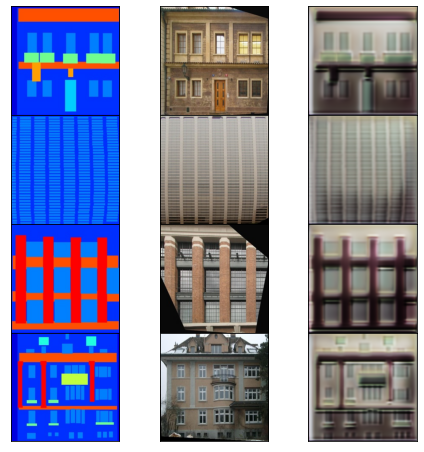

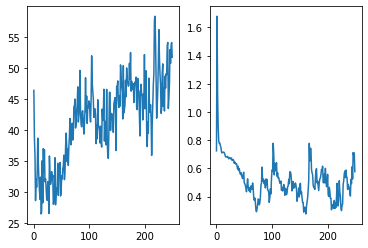

  0%|          | 0/25 [00:00<?, ?it/s]

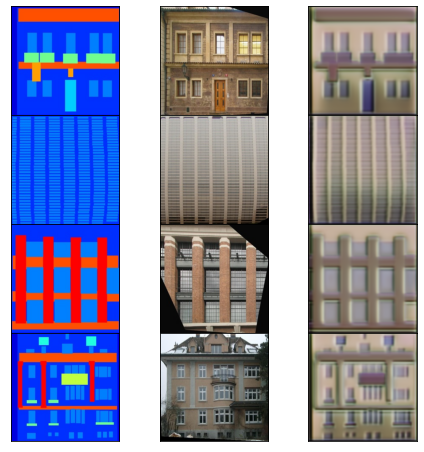

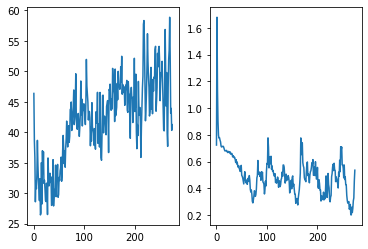

  0%|          | 0/25 [00:00<?, ?it/s]

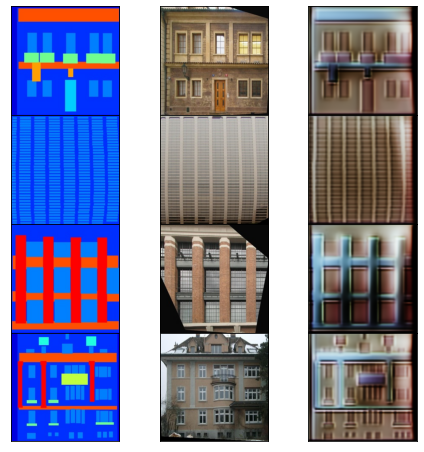

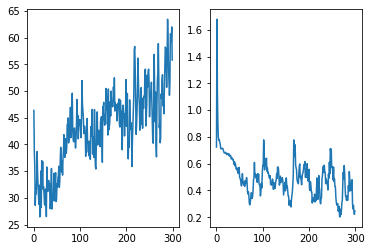

  0%|          | 0/25 [00:00<?, ?it/s]

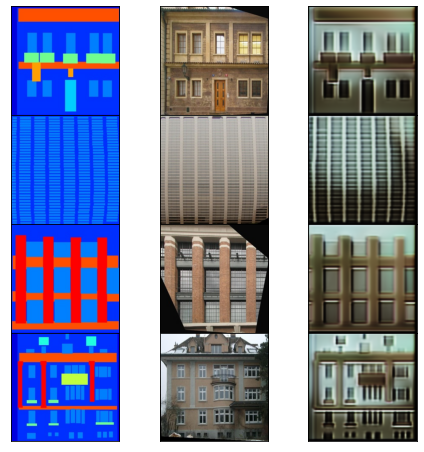

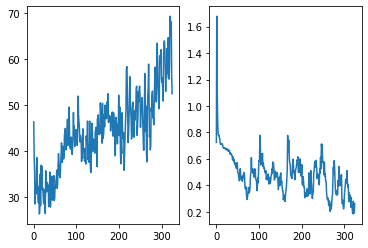

  0%|          | 0/25 [00:00<?, ?it/s]

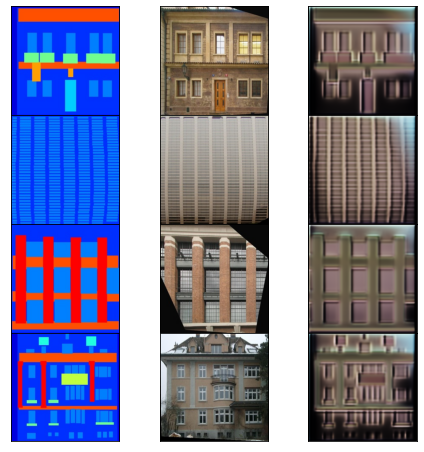

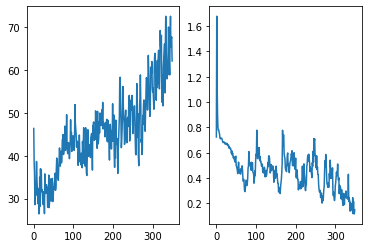

  0%|          | 0/25 [00:00<?, ?it/s]

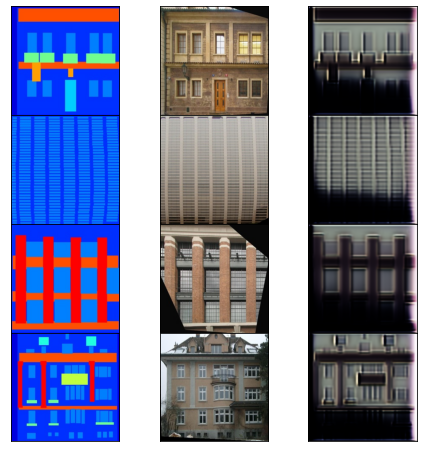

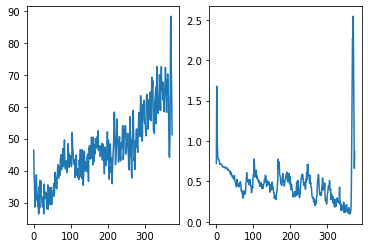

  0%|          | 0/25 [00:00<?, ?it/s]

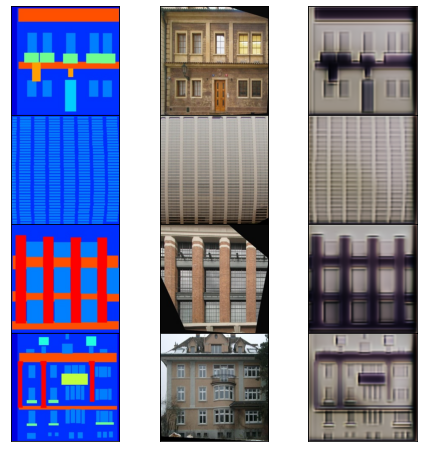

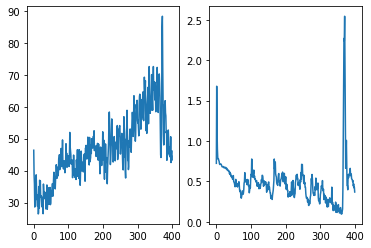

  0%|          | 0/25 [00:00<?, ?it/s]

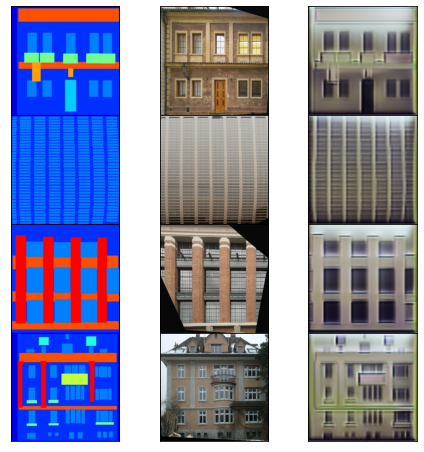

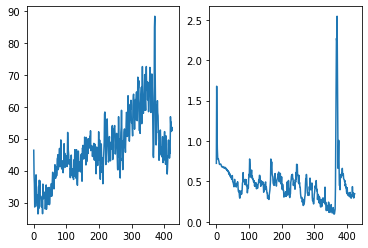

  0%|          | 0/25 [00:00<?, ?it/s]

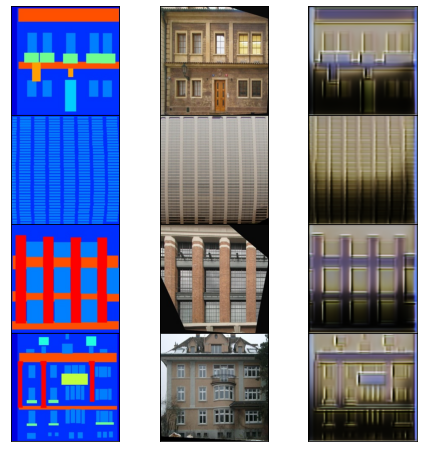

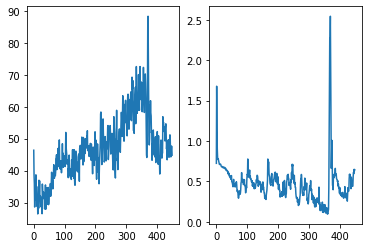

  0%|          | 0/25 [00:00<?, ?it/s]

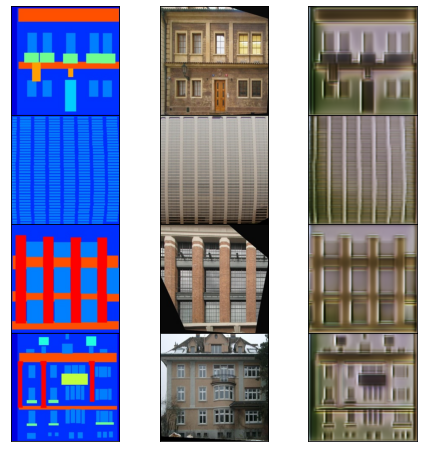

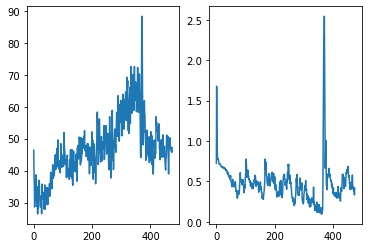

  0%|          | 0/25 [00:00<?, ?it/s]

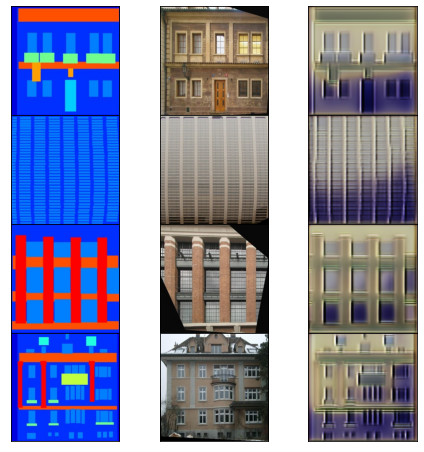

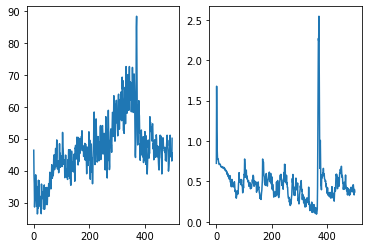

  0%|          | 0/25 [00:00<?, ?it/s]

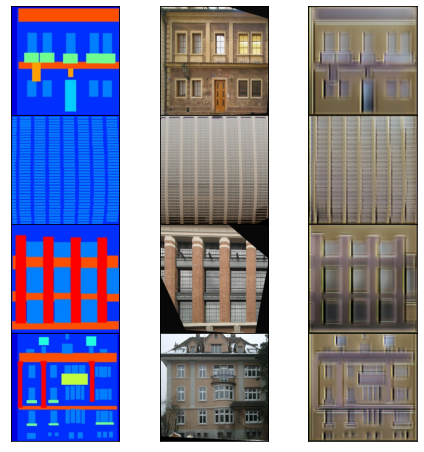

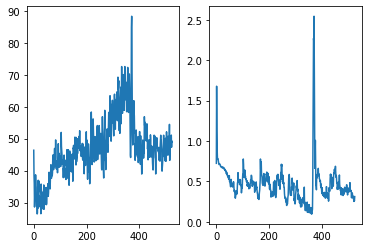

  0%|          | 0/25 [00:00<?, ?it/s]

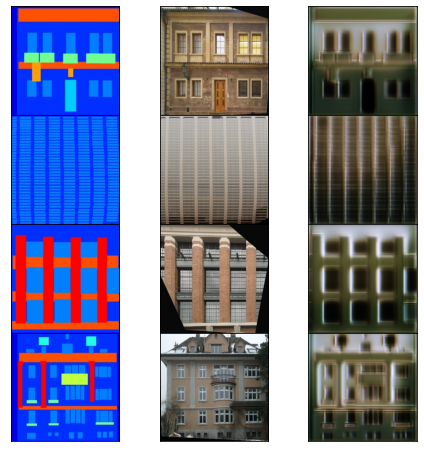

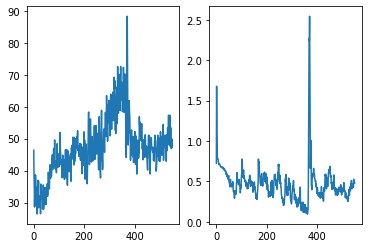

  0%|          | 0/25 [00:00<?, ?it/s]

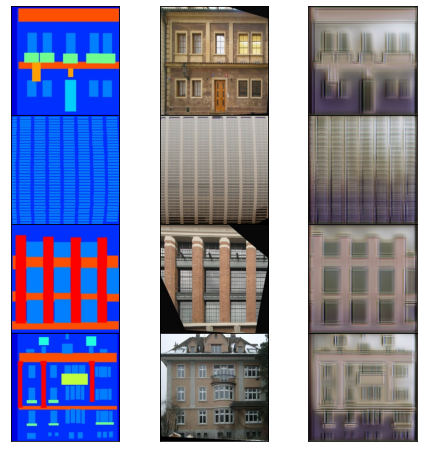

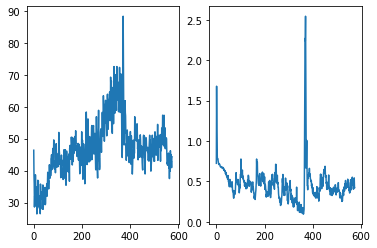

  0%|          | 0/25 [00:00<?, ?it/s]

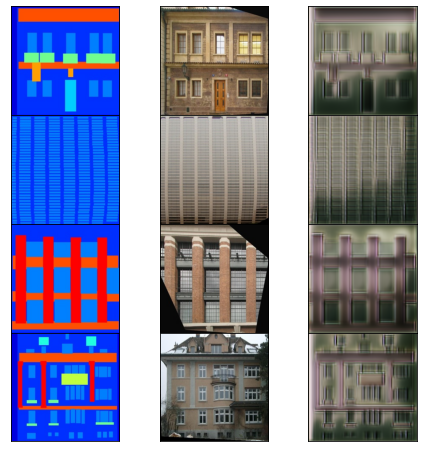

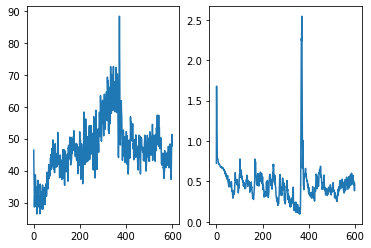

  0%|          | 0/25 [00:00<?, ?it/s]

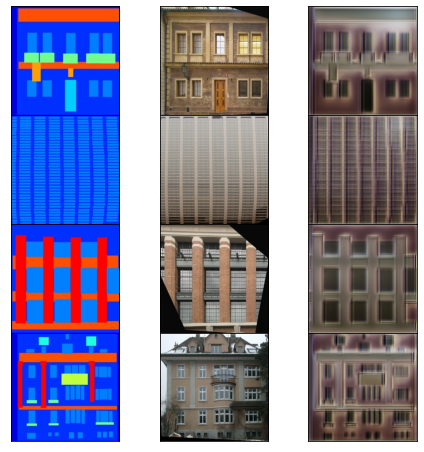

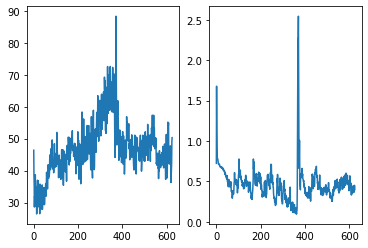

  0%|          | 0/25 [00:00<?, ?it/s]

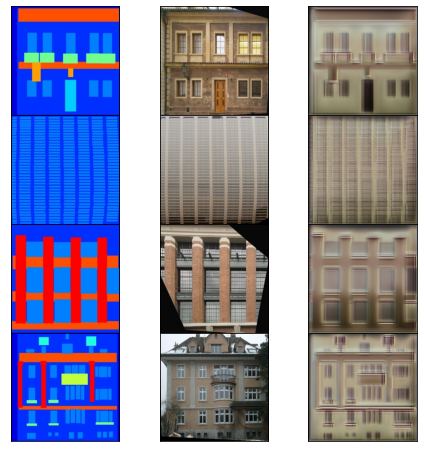

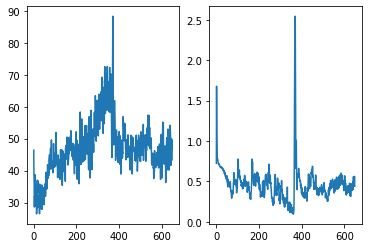

  0%|          | 0/25 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [ ]:
from IPython.display import clear_output

num_epochs = 30

g_losses, d_losses = [], []

loss_every_n_steps = 3

for e in tqdm(range(num_epochs)):

    pbar = tqdm(enumerate(train_dataloader), total=len(train_dataloader),)# leave=False, position=0)
    for i, batch in pbar:
        g_loss, d_loss = pix2pix.make_train_step(batch)
        g_losses.append(g_loss)
        d_losses.append(d_loss)
        # if i % loss_every_n_steps == 0:
        #     # clear_output()

    if e % 1 == 0:
        style_batch, condition_batch = next(iter(val_dataloader))
        generated_batch = pix2pix.generate(condition_batch)
        visualize(condition_batch, style_batch, generated_batch)
        fig, ax = plt.subplots(1, 2, figsize = (6, 4))
        ax[0].plot(g_losses)
        ax[1].plot(d_losses)
        plt.show()        


##### не то чтобы совсем никак, но..

очень нестабильное обучение, особенно в терминах цвета - нужно пробовать менять гиперпараметры и лоссы

In [ ]:
batch_size = 16

train_dataset = Pix2PixDataset(base_path = base_path / 'train')
train_dataloader = DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True
)

test_dataset = Pix2PixDataset(base_path = base_path / 'test')
test_dataloader = DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=False,
)

val_dataset = Pix2PixDataset(base_path = base_path / 'val')
val_dataloader = DataLoader(
    val_dataset,
    batch_size=4,
    shuffle=False,
)

ADD_NOISE = False
GEN_N_INPUT_CHANNELS = 3
DISC_N_INPUT_CHANNELS = GEN_N_INPUT_CHANNELS * 2
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

pix2pix = Pix2Pix(
    generator = UNet(GEN_N_INPUT_CHANNELS + int(ADD_NOISE), GEN_N_INPUT_CHANNELS, num_downs = 6, use_dropout=False),
    discriminator = PatchGAN(DISC_N_INPUT_CHANNELS + int(ADD_NOISE), ndf = 8, n_layers=3, norm_layer = nn.InstanceNorm2d),
    # discriminator_loss_fn=nn.BCEWithLogitsLoss(reduction='mean'),
    # restoration_loss_fn=torch.nn.SmoothL1Loss(),
    discriminator_loss_fn=nn.MSELoss(reduction='mean'),
    restoration_loss_fn=nn.L1Loss(),
    generator_d_loss_weight = 1e1,
    generator_r_loss_weight = 1e3,
    device = device,    
)

cuda


In [ ]:
num_epochs = 30
g_losses, d_losses = [], []

for e in tqdm(range(num_epochs)):

    pbar = tqdm(enumerate(train_dataloader), total=len(train_dataloader),)
    for i, batch in pbar:
        g_loss, d_loss = pix2pix.make_train_step(batch, add_noise=ADD_NOISE)
        g_losses.append(g_loss)
        d_losses.append(d_loss)
    if e % 1 == 0:
        style_batch, condition_batch = next(iter(val_dataloader))
        generated_batch = pix2pix.generate(condition_batch, ADD_NOISE)
        visualize(condition_batch, style_batch, generated_batch)
        fig, ax = plt.subplots(1, 2, figsize = (6, 4))
        ax[0].plot(g_losses)
        ax[1].plot(d_losses)
        plt.show()

----------validation----------


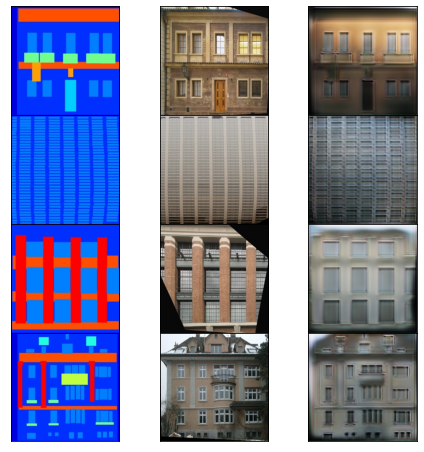

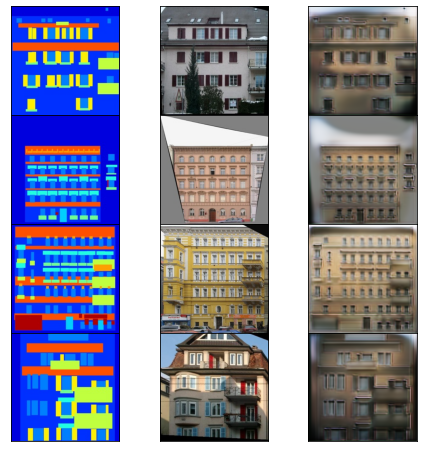

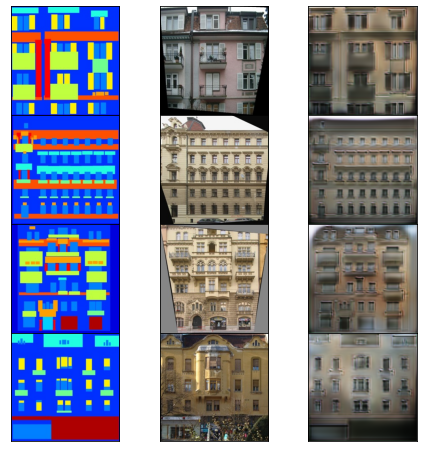

----------train----------


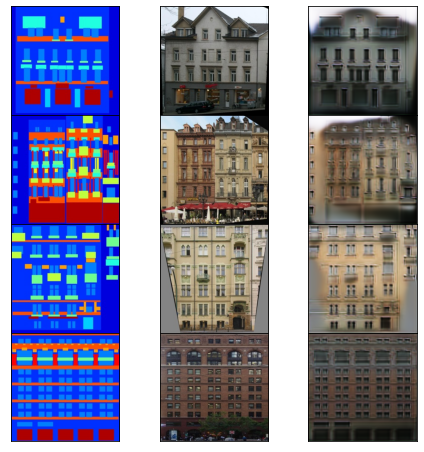

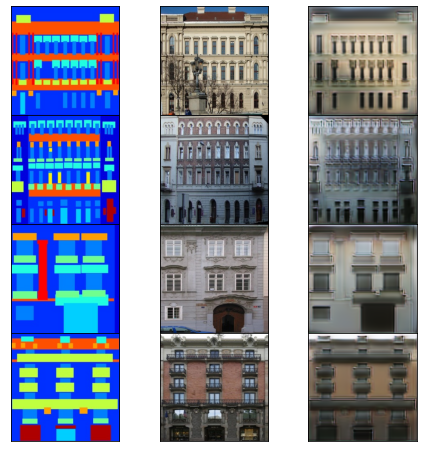

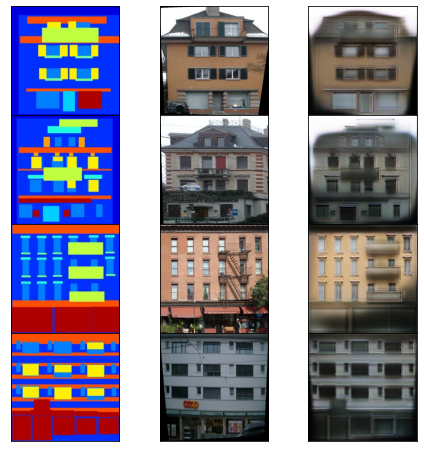

In [ ]:
print('-'*10 + 'validation' + '-'*10)

for i, (style_batch, condition_batch) in enumerate(val_dataloader):
    if i > 2:
        break
    generated_batch = pix2pix.generate(condition_batch, ADD_NOISE)
    visualize(condition_batch, style_batch, generated_batch)

print('-'*10 + 'train' + '-'*10)
for i, (style_batch, condition_batch) in enumerate(DataLoader(
    train_dataset,
    batch_size=4,
    shuffle=True,
)):
    if i > 2:
        break
    generated_batch = pix2pix.generate(condition_batch, ADD_NOISE)
    visualize(condition_batch, style_batch, generated_batch)    

##### seems alright, let's add variety in generation through noise channel

In [ ]:
batch_size = 16

train_dataset = Pix2PixDataset(base_path = base_path / 'train')
train_dataloader = DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True
)

test_dataset = Pix2PixDataset(base_path = base_path / 'test')
test_dataloader = DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=False,
)

val_dataset = Pix2PixDataset(base_path = base_path / 'val')
val_dataloader = DataLoader(
    val_dataset,
    batch_size=4,
    shuffle=False,
)

ADD_NOISE = True ###
GEN_N_INPUT_CHANNELS = 3
DISC_N_INPUT_CHANNELS = GEN_N_INPUT_CHANNELS * 2
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

pix2pix = Pix2Pix(
    generator = UNet(GEN_N_INPUT_CHANNELS + int(ADD_NOISE), GEN_N_INPUT_CHANNELS, num_downs = 6, use_dropout=False),
    discriminator = PatchGAN(DISC_N_INPUT_CHANNELS + int(ADD_NOISE), ndf = 8, n_layers=3, norm_layer = nn.InstanceNorm2d),
    # discriminator_loss_fn=nn.BCEWithLogitsLoss(reduction='mean'),
    # restoration_loss_fn=torch.nn.SmoothL1Loss(),
    discriminator_loss_fn=nn.MSELoss(reduction='mean'),
    restoration_loss_fn=nn.L1Loss(),
    generator_d_loss_weight = 1e1,
    generator_r_loss_weight = 1e3,
    device = device,    
)

cuda


In [ ]:
num_epochs = 30
g_losses, d_losses = [], []

for e in tqdm(range(num_epochs)):

    pbar = tqdm(enumerate(train_dataloader), total=len(train_dataloader),)
    for i, batch in pbar:
        g_loss, d_loss = pix2pix.make_train_step(batch, add_noise=ADD_NOISE)
        g_losses.append(g_loss)
        d_losses.append(d_loss)
    if e % 1 == 0:
        style_batch, condition_batch = next(iter(val_dataloader))
        generated_batch = pix2pix.generate(condition_batch, ADD_NOISE)
        visualize(condition_batch, style_batch, generated_batch)
        fig, ax = plt.subplots(1, 2, figsize = (6, 4))
        ax[0].plot(g_losses)
        ax[1].plot(d_losses)
        plt.show()

----------validation----------


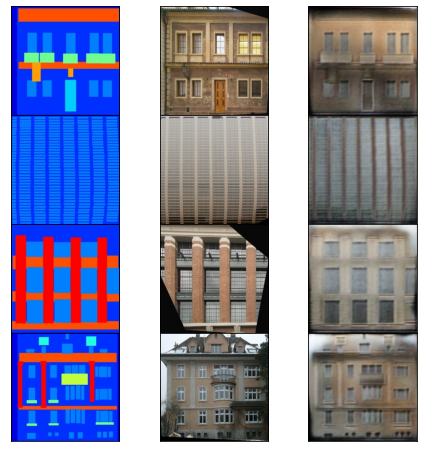

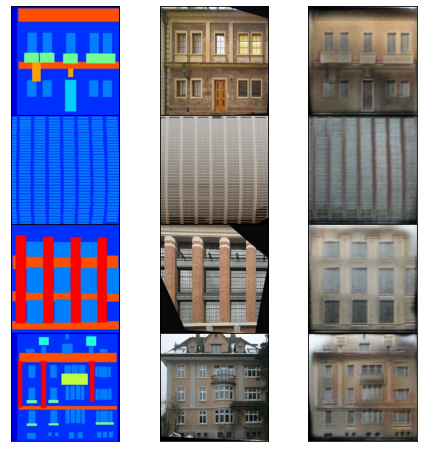

----------train----------


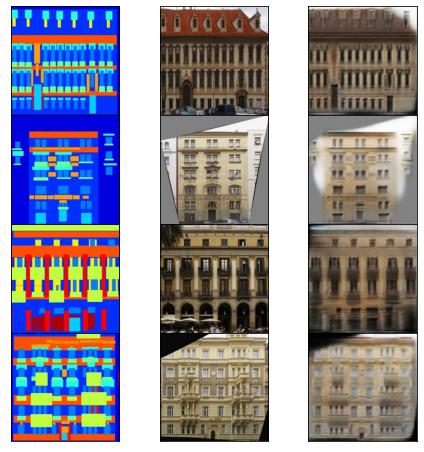

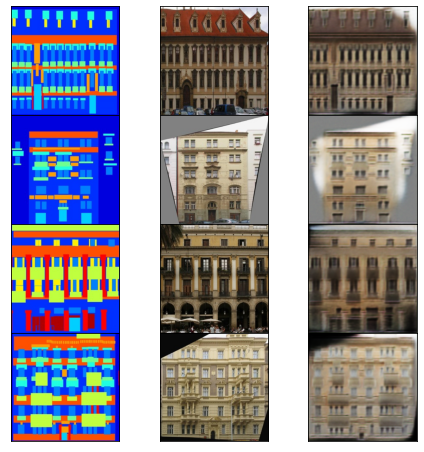

In [ ]:
print('-'*10 + 'validation' + '-'*10)

for i, (style_batch, condition_batch) in enumerate(val_dataloader):
    if i > 0:
        break
    for _ in range(2):
        generated_batch = pix2pix.generate(condition_batch, ADD_NOISE)
        visualize(condition_batch, style_batch, generated_batch)    

print('-'*10 + 'train' + '-'*10)
for i, (style_batch, condition_batch) in enumerate(DataLoader(
    train_dataset,
    batch_size=4,
    shuffle=True,
)):
    if i > 0:
        break
    for _ in range(2):
        generated_batch = pix2pix.generate(condition_batch, ADD_NOISE)
        visualize(condition_batch, style_batch, generated_batch)    

##### какая-то разница есть, но не сказать, что сильно заметно

вероятно, добавляя шум всей картой модель в итоге учится игнорировать его, нужно какое-то другое подмешивание, например, через tile, но поскольку есть reconstruction-лосс, скорее всего будет тоже самое, можно пробовать убирать дальше эту часть и учиться только с дискриминатором

### Вторая часть -- реализация CycleGAN. 

Предлагается на том же датасете реализовать
базовую конструкцию CycleGAN для unpaired style transfer, то есть переноса стилей,
каждый из которых задан неразмеченным датасетом (подробнее см. лекцию и собственно
Zhu et al., 2017):

#### Horse2Zebra Dataset 

https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/

In [ ]:
!wget https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/horse2zebra.zip
# !mkdir /content/h2z
!unzip horse2zebra.zip -d /content/

In [ ]:
base_path = Path('/content/horse2zebra/')

paths = defaultdict(list)
shapes = defaultdict(list)
for d in ['trainA', 'trainB', 'testA', 'testB']:
    paths[d] = sorted([os.path.abspath(base_path / d / f) for f in os.listdir(base_path / d)])
    print(len(paths[d]))
    for p in paths[d]:
        img = plt.imread(p)
        shapes[img.shape].append(p)

1067
1334
120
140


##### removing several 1-channel photos

In [ ]:
# print(shapes.keys())
# print(len(shapes[(256, 256)]))
# print(len(shapes[(256, 256, 3)]))

# shapes[(256, 256)]

dict_keys([(256, 256, 3), (256, 256)])
7
2654


['/content/horse2zebra/trainB/n02391049_226.jpg',
 '/content/horse2zebra/trainB/n02391049_2341.jpg',
 '/content/horse2zebra/trainB/n02391049_2361.jpg',
 '/content/horse2zebra/trainB/n02391049_2757.jpg',
 '/content/horse2zebra/trainB/n02391049_7503.jpg',
 '/content/horse2zebra/trainB/n02391049_8008.jpg',
 '/content/horse2zebra/trainB/n02391049_9726.jpg']

In [ ]:
# figsize = (6,4)
# for p in shapes[(256, 256)]:
#     fig, ax = plt.subplots(1,1,figsize = figsize)
#     img = plt.imread(p)
#     ax.imshow(img);

In [7]:
EXCLUDE_PATHS = set([
    'n02391049_226.jpg',
    'n02391049_2341.jpg',
    'n02391049_2361.jpg',
    'n02391049_2757.jpg',
    'n02391049_7503.jpg',
    'n02391049_8008.jpg',
    'n02391049_9726.jpg',
])

class DomainDataset(torch.utils.data.Dataset):
    def __init__(self, base_path):
        self.base_path = Path(base_path)
        self.img_paths = sorted([base_path / f for f in os.listdir(base_path) if f.endswith('.jpg') and f not in EXCLUDE_PATHS])
        self.transforms = transforms.Compose([transforms.ToTensor(),])

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        p = self.img_paths[idx]
        img = plt.imread(p) ### h x w x c
        return self.transforms(img)

#### Visualize CycleGAN results

In [8]:
from matplotlib import gridspec

def visualize_cyclegan(trueA_batch, generatedA_batch, trueB_batch, generatedB_batch, figsize=(8, 8)):
    n = len(trueA_batch)
    fig = plt.figure(figsize=figsize,)
    nrow, ncol = n, 4
    gs = gridspec.GridSpec(
        nrow, ncol, wspace=0.0, hspace=0.0,
    )
    for i in range(nrow):
        tA, gA, tB, gB = trueA_batch[i], generatedA_batch[i], trueB_batch[i], generatedB_batch[i]
        # back to h x w x c
        tA, gA, tB, gB = (
            tA.detach().cpu().permute(1, 2, 0).numpy(),
            gA.detach().cpu().permute(1, 2, 0).numpy(),
            tB.detach().cpu().permute(1, 2, 0).numpy(),
            gB.detach().cpu().permute(1, 2, 0).numpy(),
        )        
        for j, element in zip(range(ncol), (tA, gA, tB, gB)):
            ax = plt.subplot(gs[i, j])
            ax.imshow(element)
            ax.set_xticklabels([])
            ax.set_yticklabels([])
            ax.set_xticks([])
            ax.set_yticks([])       
    plt.show();

[267, 30, 332, 35]


/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:126: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ../torch/csrc/utils/tensor_numpy.cpp:189.)
  img = torch.from_numpy(pic.transpose((2, 0, 1))).contiguous()


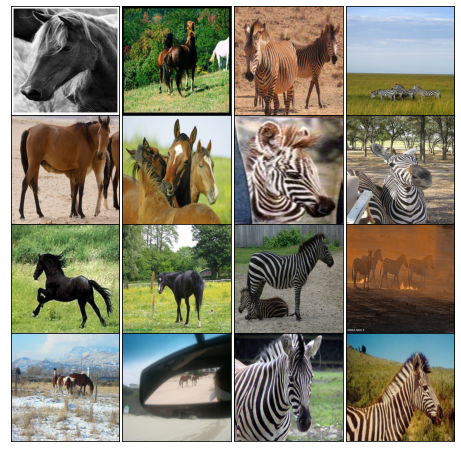

In [ ]:
batch_size = 4

trainA_dataset = DomainDataset(base_path = base_path / 'trainA')
trainA_dataloader = DataLoader(
    trainA_dataset,
    batch_size=batch_size,
    shuffle=True
)

testA_dataset = DomainDataset(base_path = base_path / 'testA')
testA_dataloader = DataLoader(
    testA_dataset,
    batch_size=batch_size,
    shuffle=False,
)

trainB_dataset = DomainDataset(base_path = base_path / 'trainB')
trainB_dataloader = DataLoader(
    trainB_dataset,
    batch_size=batch_size,
    shuffle=True
)

testB_dataset = DomainDataset(base_path = base_path / 'testB')
testB_dataloader = DataLoader(
    testB_dataset,
    batch_size=batch_size,
    shuffle=False,
)

print([len(dl) for dl in [trainA_dataloader, testA_dataloader, trainB_dataloader, testB_dataloader]])

trueA_batch, generatedA_batch, trueB_batch, generatedB_batch = (
    [next(iter(dl)) for dl in [trainA_dataloader, testA_dataloader, trainB_dataloader, testB_dataloader]]
)

visualize_cyclegan(trueA_batch, generatedA_batch, trueB_batch, generatedB_batch)

#### CycleGAN 

In [9]:
import itertools

class CycleGAN:
    def __init__(
        self,

        generatorAB, ## AtoB
        generatorBA, ## BtoA
        discriminatorA, ## !in A domain! == after generatorBA
        discriminatorB, ## !in B domain! == after generatorAB

        discriminator_loss_fn = nn.BCEWithLogitsLoss(reduction = 'mean'), ### 
        cycle_loss_fn = torch.nn.L1Loss(), ### when image from domain X goes through generatorXY and then generatorYX - output should be close to initial input
        identity_loss_fn = torch.nn.SmoothL1Loss(), ### when image from domain X goes through generator YX output should be close to initial input
        
        lambda_identity = 1e0,
        lambdaA = 1e1,
        lambdaB = 1e1,

        learning_rate = 0.0002,
        device = 'cpu',
    ):

        self.device = device

        self.generatorAB = generatorAB.to(self.device)
        self.generatorBA = generatorBA.to(self.device)
        self.discriminatorA = discriminatorA.to(self.device)
        self.discriminatorB = discriminatorB.to(self.device)

        self.discriminator_loss_fn = discriminator_loss_fn
        self.cycle_loss_fn = cycle_loss_fn
        self.identity_loss_fn = identity_loss_fn

        self.lambda_identity = lambda_identity
        self.lambdaA = lambdaA
        self.lambdaB = lambdaB

        self.g_optimizer = torch.optim.Adam(
            itertools.chain(self.generatorAB.parameters(), self.generatorBA.parameters()),
            lr=learning_rate, 
        )
        self.d_optimizer = torch.optim.Adam(
            itertools.chain(self.discriminatorA.parameters(), self.discriminatorB.parameters()),
            lr=learning_rate, 
        )

    def backward_D(self, discriminator, real, generated):
        """
        calculates adversarial loss for the discriminator
        note also calling loss_D.backward() to calculate the gradients.
        """
        # real
        logits_real = discriminator(real)
        ones = torch.tensor(1.0).expand_as(logits_real).to(self.device)
        loss_D_real = self.discriminator_loss_fn(logits_real, ones)
        # generated
        logits_generated = discriminator(generated.detach()) #### detaching gradients as we're optimizing only discriminator here
        zeros = torch.tensor(0.0).expand_as(logits_generated).to(self.device)
        loss_D_generated = self.discriminator_loss_fn(logits_generated, zeros)
        # combined loss and calculate gradients
        loss_D = (loss_D_real + loss_D_generated) / 2
        loss_D.backward()
        return loss_D

    def backward_D_A(self, real_A, generated_A):
        """calculates adversarial loss for discriminatorA"""
        loss_D_A = self.backward_D(self.discriminatorA, real_A, generated_A)
        return loss_D_A

    def backward_D_B(self, real_B, generated_B):
        """calculates adversarial loss for discriminatorB"""
        loss_D_B = self.backward_D(self.discriminatorB, real_B, generated_B)
        return loss_D_B

    def forward_G(self, real_A, real_B):
        """Run forward pass; called by both functions <optimize_parameters> and <test>."""
        generated_B = self.generatorAB(real_A)  # G_A(A)
        reconstructed_A = self.generatorBA(generated_B)   # G_B(G_A(A))
        generated_A = self.generatorBA(real_B)  # G_B(B)
        reconstructed_B = self.generatorAB(generated_A)   # G_A(G_B(B))
        return generated_A, generated_B, reconstructed_A, reconstructed_B

    def backward_G(self, real_A, real_B, generated_A, generated_B, reconstructed_A, reconstructed_B):
        """calculates the loss for generators and calls backward"""
        
        # identity loss
        if self.lambda_identity > 0:
            # G_AB should be identity if real_B is fed: ||G_AB(B) - B||
            identity_B = self.generatorAB(real_B)
            loss_id_A = self.identity_loss_fn(identity_B, real_B) * self.lambda_identity * self.lambdaA
            # G_BA should be identity if real_A is fed: ||G_BA(A) - A||
            identity_A = self.generatorBA(real_A)
            loss_id_B = self.identity_loss_fn(identity_A, real_A) * self.lambda_identity * self.lambdaB
        else:
            loss_id_A, loss_id_B = 0, 0

        # adversarial loss D_B(G_AB(A))
        logits_generated_B = self.discriminatorB(generated_B.detach())
        ones_B = torch.tensor(1.0).expand_as(logits_generated_B).to(self.device)
        loss_G_A = self.discriminator_loss_fn(logits_generated_B, ones_B)
        # adversarial loss D_A(G_BA(B))
        logits_generated_A = self.discriminatorA(generated_A.detach())
        ones_A = torch.tensor(1.0).expand_as(logits_generated_A).to(self.device)        
        loss_G_B = self.discriminator_loss_fn(logits_generated_A, ones_A)
        # Forward cycle loss || G_BA(G_AB(A)) - A||
        loss_cycle_A = self.cycle_loss_fn(reconstructed_A, real_A) * self.lambdaA
        # Backward cycle loss || G_AB(G_BA(B)) - B||
        loss_cycle_B = self.cycle_loss_fn(reconstructed_B, real_B) * self.lambdaB
        # combined loss and backward
        loss_G = (
            loss_G_A + loss_G_B +
            loss_cycle_A + loss_cycle_B +
            loss_id_A + loss_id_B
        )
        loss_G.backward()
        return loss_G_A, loss_G_B, loss_cycle_A, loss_cycle_B, loss_id_A, loss_id_B

    def make_train_step(self, real_A, real_B):
        """calculate losses and updates network weights; called in every training iteration"""
        
        self.generatorAB.train()
        self.generatorBA.train()
        self.discriminatorA.train()
        self.discriminatorB.train()

        real_A, real_B = real_A.to(self.device), real_B.to(self.device)
        # forward
        generated_A, generated_B, reconstructed_A, reconstructed_B = self.forward_G(real_A, real_B)
        # G_A and G_B
        self.set_requires_grad([self.discriminatorA, self.discriminatorB], False)  # Ds require no gradients when optimizing Gs
        self.g_optimizer.zero_grad()  # set G_A and G_B's gradients to zero
        loss_G_A, loss_G_B, loss_cycle_A, loss_cycle_B, loss_id_A, loss_id_B = (
            self.backward_G(real_A, real_B, generated_A, generated_B, reconstructed_A, reconstructed_B)
        )
        self.g_optimizer.step()       # update G_A and G_B's weights
        # D_A and D_B
        self.set_requires_grad([self.discriminatorA, self.discriminatorB], True)
        self.d_optimizer.zero_grad()   # set D_A and D_B's gradients to zero
        loss_D_A = self.backward_D_A(real_A, generated_A)      # calculate gradients for D_A
        loss_D_B = self.backward_D_B(real_B, generated_B)      # calculate graidents for D_B
        self.d_optimizer.step()  # update D_A and D_B's weights

        return (
            loss_D_A, loss_D_B,
            loss_G_A, loss_G_B,
            loss_cycle_A, loss_cycle_B,
            loss_id_A, loss_id_B
        )

    def generate_A(self, input):
        self.generatorBA.eval()
        with torch.no_grad():
            generated = self.generatorBA(input.to(self.device))
        return generated
    
    def generate_B(self, input):
        self.generatorAB.eval()
        with torch.no_grad():
            generated = self.generatorAB(input.to(self.device))
        return generated

    def set_requires_grad(self, nets, requires_grad: bool):
        """
        setting requires_grad for all the networks to avoid unnecessary computations
        """
        if not isinstance(nets, list):
            nets = [nets]
        for net in nets:
            if net is not None:
                for param in net.parameters():
                    param.requires_grad = requires_grad

#### Training

In [ ]:
batch_size = 8

trainA_dataset = DomainDataset(base_path = base_path / 'trainA')
trainA_dataloader = DataLoader(
    trainA_dataset,
    batch_size=batch_size,
    shuffle=True,
    # num_workers = 2,
)

testA_dataset = DomainDataset(base_path = base_path / 'testA')
testA_dataloader = DataLoader(
    testA_dataset,
    batch_size=4,
    shuffle=True,
)

trainB_dataset = DomainDataset(base_path = base_path / 'trainB')
trainB_dataloader = DataLoader(
    trainB_dataset,
    batch_size=batch_size,
    shuffle=True,
    # num_workers = 2,
)

testB_dataset = DomainDataset(base_path = base_path / 'testB')
testB_dataloader = DataLoader(
    testB_dataset,
    batch_size=4,
    shuffle=True,
)

In [ ]:
from google.colab import drive
from pathlib import Path
drive.mount('/content/gdrive/')
path_to_files = Path('/content/gdrive/My Drive/_made/advanced_ml/')

GEN_N_INPUT_CHANNELS = 3
DISC_N_INPUT_CHANNELS = GEN_N_INPUT_CHANNELS
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

cyclegan = CycleGAN(
    generatorAB = UNet(GEN_N_INPUT_CHANNELS, GEN_N_INPUT_CHANNELS, num_downs = 6, use_dropout=False),
    generatorBA = UNet(GEN_N_INPUT_CHANNELS, GEN_N_INPUT_CHANNELS, num_downs = 6, use_dropout=False),
    # discriminatorA = PatchGAN(DISC_N_INPUT_CHANNELS, ndf = 8, n_layers=3, norm_layer = nn.InstanceNorm2d),
    # discriminatorB = PatchGAN(DISC_N_INPUT_CHANNELS, ndf = 8, n_layers=3, norm_layer = nn.InstanceNorm2d),
    discriminatorA = ConvNetSimple(in_channels = 3, start_channels = 16, n_blocks = 4),
    discriminatorB = ConvNetSimple(in_channels = 3, start_channels = 16, n_blocks = 4),
    # discriminator_loss_fn=nn.BCEWithLogitsLoss(reduction='mean'),
    cycle_loss_fn=nn.L1Loss(),
    discriminator_loss_fn=nn.MSELoss(reduction='mean'),
    # cycle_loss_fn=torch.nn.SmoothL1Loss(),    
    identity_loss_fn = torch.nn.SmoothL1Loss(), 
    lambda_identity = 1e-0,
    lambdaA = 1e1,
    lambdaB = 1e1,
    device = device,
)

cyclegan.generatorAB.load_state_dict(torch.load(path_to_files / 'generatorAB.pth', map_location = 'cpu'))
cyclegan.generatorBA.load_state_dict(torch.load(path_to_files / 'generatorBA.pth', map_location = 'cpu'))

Mounted at /content/gdrive/
cuda


<All keys matched successfully>

Drive already mounted at /content/gdrive/; to attempt to forcibly remount, call drive.mount("/content/gdrive/", force_remount=True).


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/134 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:126: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ../torch/csrc/utils/tensor_numpy.cpp:189.)
  img = torch.from_numpy(pic.transpose((2, 0, 1))).contiguous()


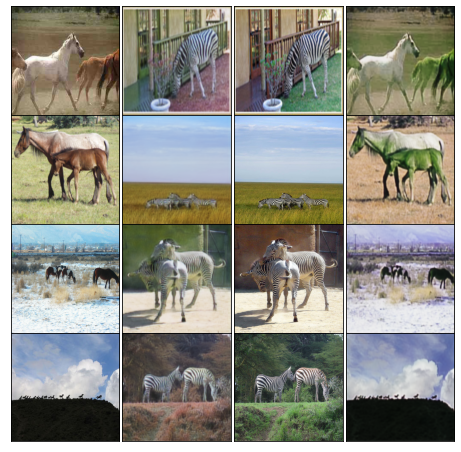

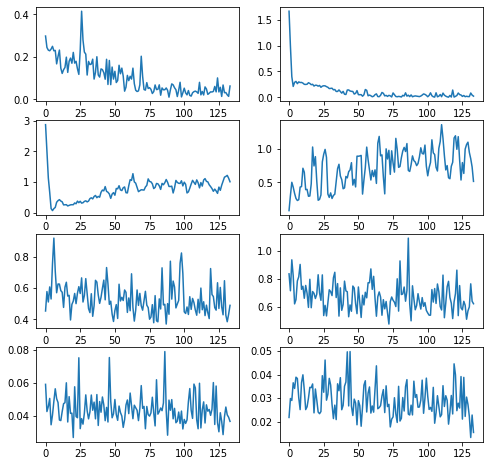

  0%|          | 0/134 [00:00<?, ?it/s]

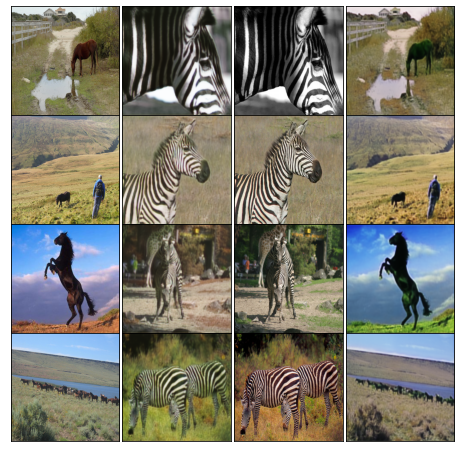

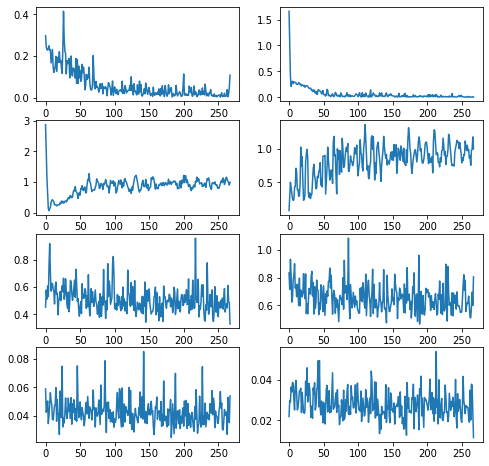

  0%|          | 0/134 [00:00<?, ?it/s]

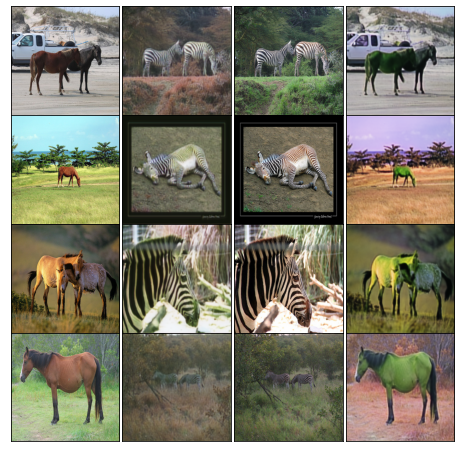

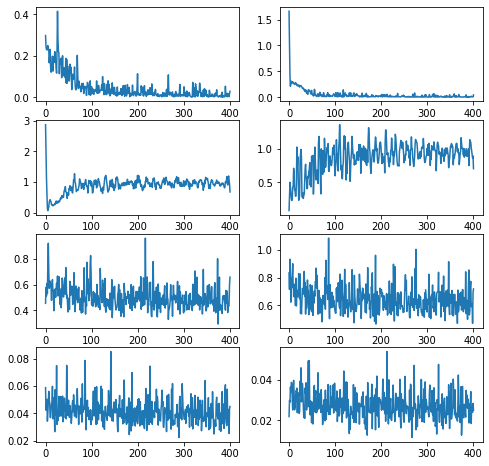

  0%|          | 0/134 [00:00<?, ?it/s]

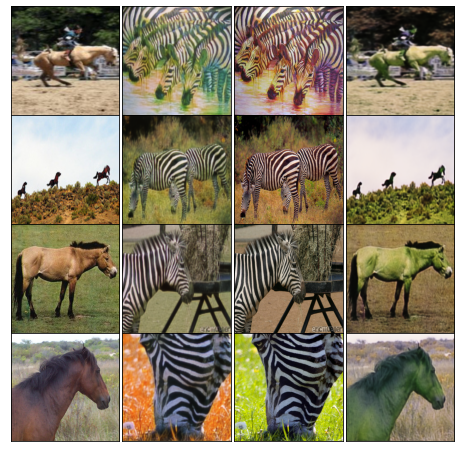

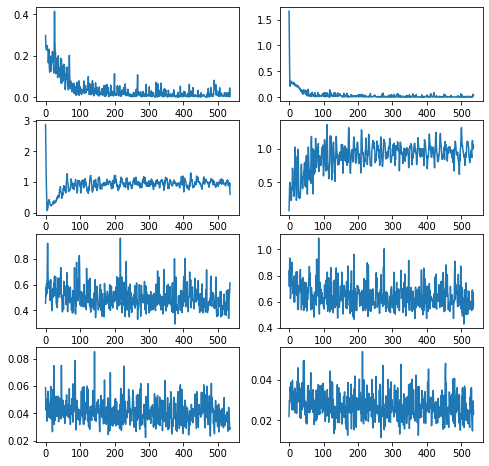

  0%|          | 0/134 [00:00<?, ?it/s]

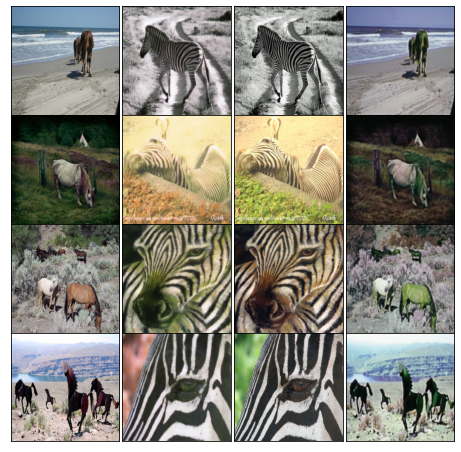

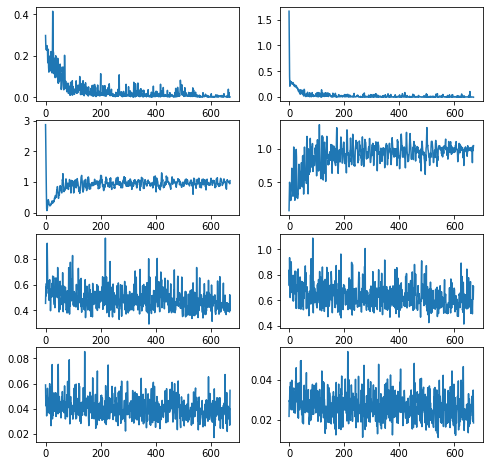

  0%|          | 0/134 [00:00<?, ?it/s]

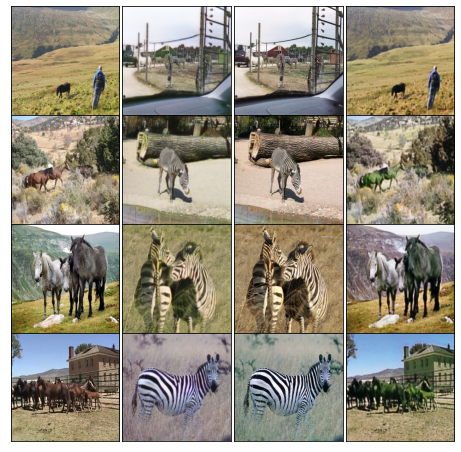

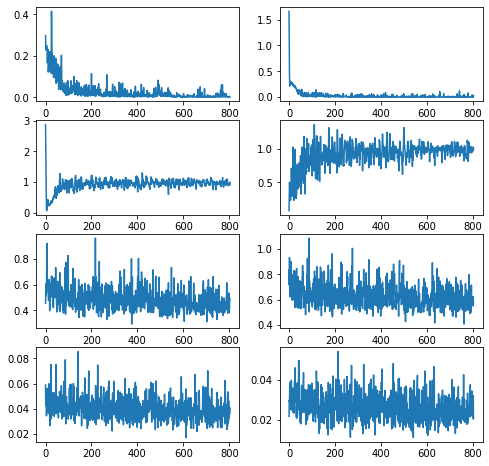

  0%|          | 0/134 [00:00<?, ?it/s]

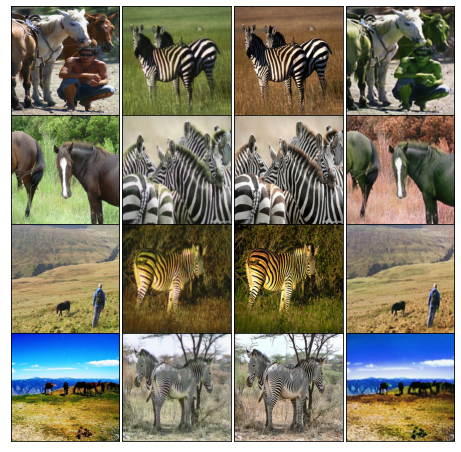

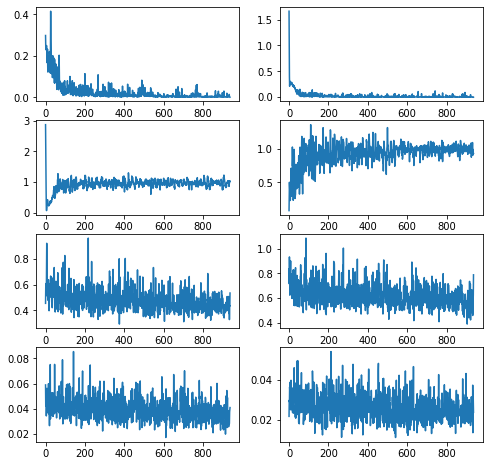

  0%|          | 0/134 [00:00<?, ?it/s]

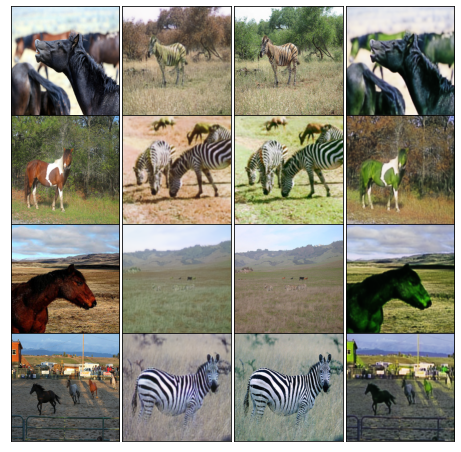

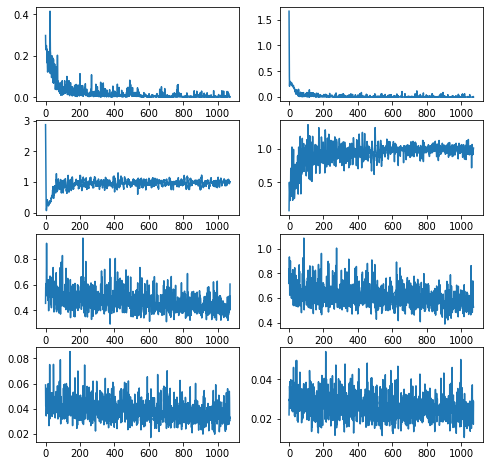

  0%|          | 0/134 [00:00<?, ?it/s]

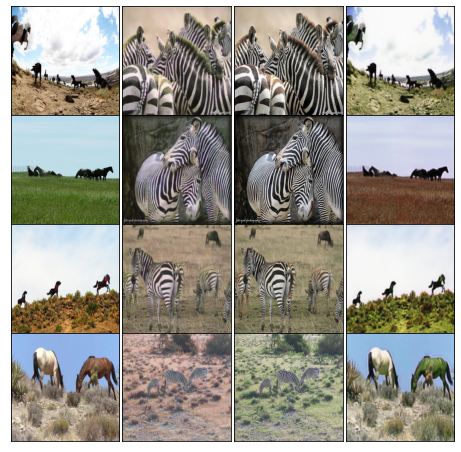

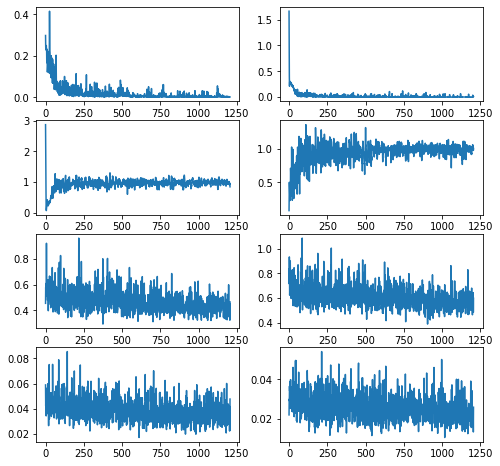

  0%|          | 0/134 [00:00<?, ?it/s]

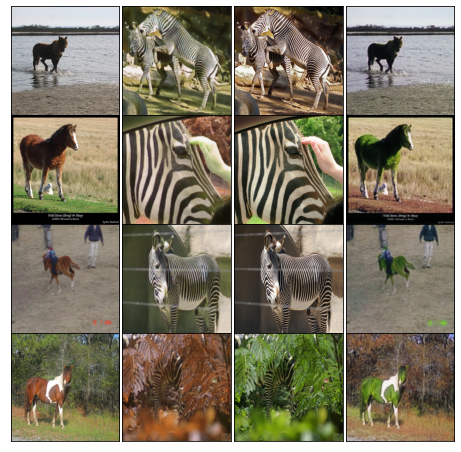

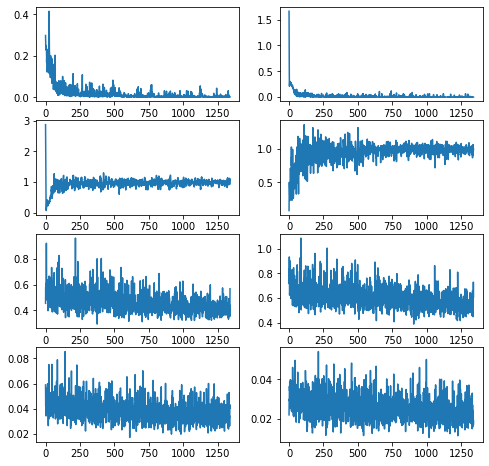

  0%|          | 0/134 [00:00<?, ?it/s]

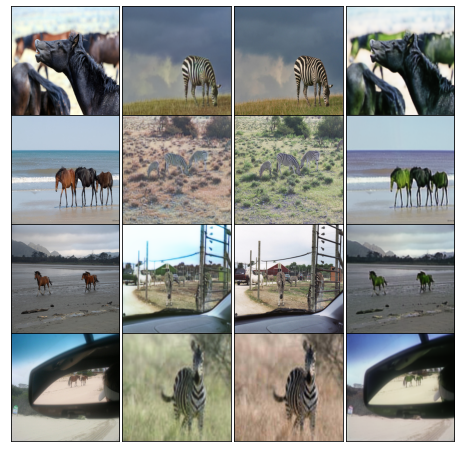

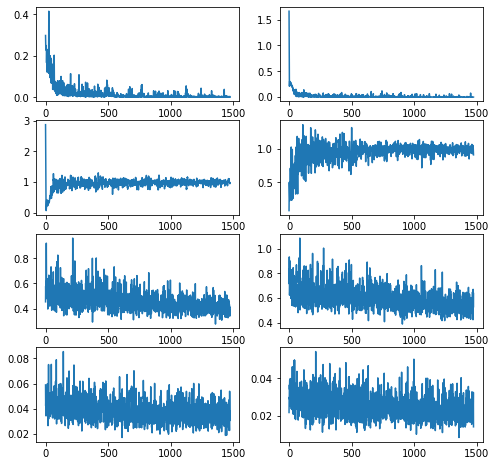

  0%|          | 0/134 [00:00<?, ?it/s]

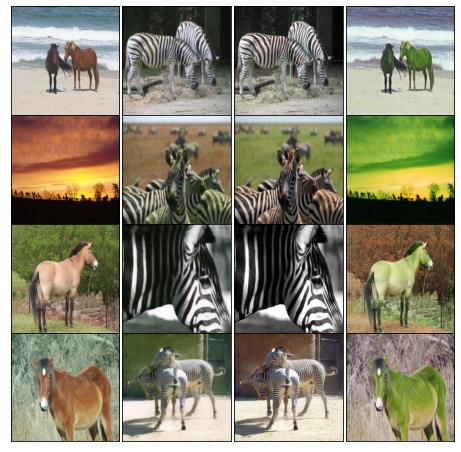

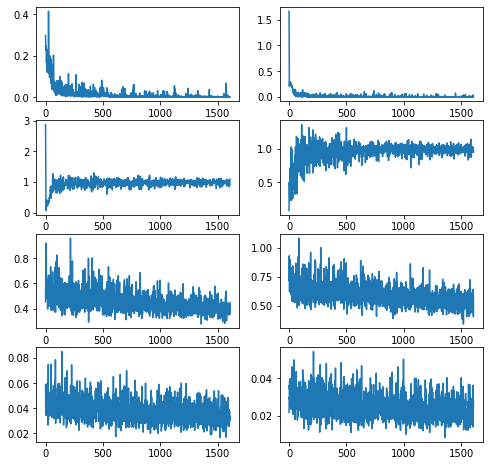

  0%|          | 0/134 [00:00<?, ?it/s]

In [ ]:
from google.colab import drive
from pathlib import Path
drive.mount('/content/gdrive/')
path_to_files = Path('/content/gdrive/My Drive/_made/advanced_ml/')

num_epochs = 80

d_a_losses, d_b_losses = [], []
g_a_losses, g_b_losses = [], []
c_a_losses, c_b_losses = [], []
id_a_losses, id_b_losses = [], []

def unpack_losses(batch_losses):
    (
        loss_D_A, loss_D_B,
        loss_G_A, loss_G_B,
        loss_cycle_A, loss_cycle_B,
        loss_id_A, loss_id_B
    ) = batch_losses

    d_a_losses.append(loss_D_A)
    g_a_losses.append(loss_G_A)
    c_a_losses.append(loss_cycle_A)
    id_a_losses.append(loss_id_A)
    d_b_losses.append(loss_D_B)
    g_b_losses.append(loss_G_B)
    c_b_losses.append(loss_cycle_B)
    id_b_losses.append(loss_id_B)

for e in tqdm(range(num_epochs)):

    pbar = tqdm(enumerate(zip(trainA_dataloader, trainB_dataloader)), total=len(trainA_dataloader),)
    for i, (real_A, real_B) in pbar:
        batch_losses = cyclegan.make_train_step(real_A, real_B)
        unpack_losses(batch_losses)
    if e % 1 == 0:
        real_A, real_B = next(iter(testA_dataloader)), next(iter(testB_dataloader))
        generated_B = cyclegan.generate_B(real_A)
        generated_A = cyclegan.generate_A(real_B)
        visualize_cyclegan(real_A, generated_A, real_B, generated_B,)
        fig, ax = plt.subplots(4, 2, figsize = (8, 8))
        ax[0][0].plot(d_a_losses)
        ax[0][1].plot(d_b_losses)
        ax[1][0].plot(g_a_losses)
        ax[1][1].plot(g_b_losses)
        ax[2][0].plot(c_a_losses)
        ax[2][1].plot(c_b_losses)
        ax[3][0].plot(id_a_losses)
        ax[3][1].plot(id_b_losses)
        plt.show()

        torch.save(cyclegan.generatorAB.state_dict(), path_to_files / 'generatorAB.pth')
        torch.save(cyclegan.generatorBA.state_dict(), path_to_files / 'generatorBA.pth')

### Generating

In [10]:
from google.colab import drive
from pathlib import Path
drive.mount('/content/gdrive/')
path_to_files = Path('/content/gdrive/My Drive/_made/advanced_ml/')

Mounted at /content/gdrive/


In [12]:
GEN_N_INPUT_CHANNELS = 3
DISC_N_INPUT_CHANNELS = GEN_N_INPUT_CHANNELS
device = "cuda" if torch.cuda.is_available() else "cpu"

cyclegan = CycleGAN(
    generatorAB = UNet(GEN_N_INPUT_CHANNELS, GEN_N_INPUT_CHANNELS, num_downs = 6, use_dropout=False),
    generatorBA = UNet(GEN_N_INPUT_CHANNELS, GEN_N_INPUT_CHANNELS, num_downs = 6, use_dropout=False),
    discriminatorA = PatchGAN(DISC_N_INPUT_CHANNELS, ndf = 8, n_layers=3, norm_layer = nn.InstanceNorm2d),
    discriminatorB = PatchGAN(DISC_N_INPUT_CHANNELS, ndf = 8, n_layers=3, norm_layer = nn.InstanceNorm2d),
    # discriminator_loss_fn=nn.BCEWithLogitsLoss(reduction='mean'),
    cycle_loss_fn=nn.L1Loss(),
    discriminator_loss_fn=nn.MSELoss(reduction='mean'),
    # cycle_loss_fn=torch.nn.SmoothL1Loss(),    
    identity_loss_fn = torch.nn.SmoothL1Loss(), 
    lambda_identity = 1e-0,
    lambdaA = 1e1,
    lambdaB = 1e1,
    device = device,
)

cyclegan.generatorAB.load_state_dict(torch.load(path_to_files / 'generatorAB.pth', map_location = 'cpu'))
cyclegan.generatorBA.load_state_dict(torch.load(path_to_files / 'generatorBA.pth', map_location = 'cpu'))

<All keys matched successfully>

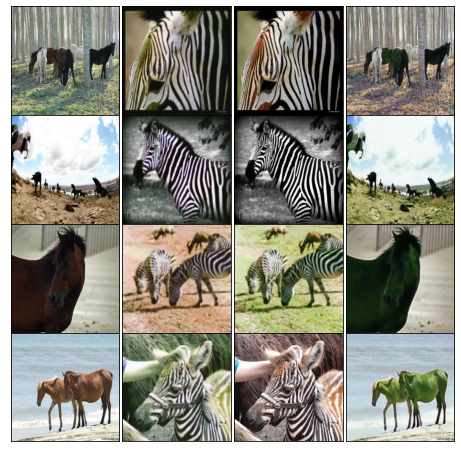

In [16]:
base_path = Path('/content/horse2zebra/')

testA_dataset = DomainDataset(base_path = base_path / 'testA')
testA_dataloader = DataLoader(
    testA_dataset,
    batch_size=4,
    shuffle=True,
)

testB_dataset = DomainDataset(base_path = base_path / 'testB')
testB_dataloader = DataLoader(
    testB_dataset,
    batch_size=4,
    shuffle=True,
)


real_A, real_B = next(iter(testA_dataloader)), next(iter(testB_dataloader))
generated_B = cyclegan.generate_B(real_A)
generated_A = cyclegan.generate_A(real_B)
visualize_cyclegan(real_A, generated_A, real_B, generated_B,)

stylegan на момент отправки съел ресурсы колаба и недоучился

ландшафт меняется даже более менее адекватно иногда, но вот звери зелёными быть не должны - возможно, стоит отключить identity loss или сделать еще слабее дискриминаторы, учится медленно, много гипотез проверить не успевается